In [1]:
from pathlib import Path
import pickle
import pandas as pd
import torch
import matplotlib.pyplot as plt
import json
from os import path

In [2]:
data_dir = '/h/ypark/tweet_covid/hatespeech/output/embedding'
hb_dir = "/h/ypark/tweet_covid/hatespeech/hatebase"

def get_embedding(data_dir, chunk_id):
    with open(Path(data_dir, "chunk_{}_embedding.pkl".format(chunk_id)) , 'rb') as f:
        data = pickle.load(f)
    
    return data

hate_df = pd.DataFrame()

def load_speech(data_dir, i):
    
    fn = Path(hb_dir, "hatebase_eng{}".format(i))
    words = None
    try:
        with open(fn, 'rb') as f:
            words = json.loads(f.read())
    except:
        print(i)
        raise ValueError("File not exists")
    
    return words['result']

for i in range(1,16):
    df = load_speech(hb_dir, i)    
    df = pd.DataFrame(df) 
    hate_df = hate_df.append(df)
    
combined = {}
for i in range(444):
    if path.exists(Path(data_dir, "chunk_{}_embedding.pkl".format(i))):
        chunk = get_embedding(data_dir, i)
        for term in chunk.keys():
            if term in combined.keys():
                for day in chunk[term]:
                    combined[term][day] = chunk[term][day]
            else:
                combined[term] = chunk[term]
            

In [3]:
combined_df = pd.DataFrame(combined)

bin_30 = combined_df[combined_df.index<=30]
bin_60 = combined_df[(combined_df.index<=60) & (combined_df.index > 30)]
bin_90 = combined_df[(combined_df.index<=90) & (combined_df.index > 60)]
bin_120 = combined_df[(combined_df.index<=120) & (combined_df.index > 90)]
bin_150 = combined_df[(combined_df.index<=150) & (combined_df.index > 120)]
bin_180 = combined_df[(combined_df.index<=180) & (combined_df.index > 150)]
    
combined_avg = {30:{}, 60:{}, 90:{}, 120:{}, 150:{}, 180:{}}
def get_avg_bin(df, time):
    for col in df:
        s =list(df[col].dropna())
        if len(s) > 0:
            term_avg = torch.stack(s, dim=0).mean(dim = 0)
            combined_avg[time][col] = term_avg

get_avg_bin(bin_30, 30)
get_avg_bin(bin_60, 60)
get_avg_bin(bin_90, 90)
get_avg_bin(bin_120, 120)
get_avg_bin(bin_150, 150)
get_avg_bin(bin_180, 180)


In [7]:
cos = torch.nn.CosineSimilarity(0)
base = combined_avg[30]
bins = [60,90,120,150,180]
cos_sim_dict = {}
for term in base.keys():
    cos_sim_dict[term] = {}
    vec1 = base[term]
    for b in bins:
        if term in combined_avg[b].keys():
            vec2 = combined_avg[b][term]
            sim = 1 - float(cos(vec1, vec2))
            if term not in cos_sim_dict.keys(): 
                cos_sim_dict[term] = {}
            cos_sim_dict[term][b] = sim
            
sim_dict_df = pd.DataFrame(cos_sim_dict)

sim_df_notna = sim_dict_df.dropna(axis=1)

In [8]:
classes = hate_classes_dict = {"Nationality":{}, 
                "Ethnicity":{},
                "Religion":{},
                "Gender":{},
                "Sexual Orientation":{},
                "Disability":{},
                "Class":{}}

senses = {"only_hateful_meaning":{},
          "both_meaning":{}}

ambiguous = {"is_unambiguous":{},
            "is_ambiguous":{}}

for idx, row in hate_df.iterrows():
    term = row['term']
    if term in sim_df_notna.keys():
        if row["is_about_nationality"]: 
            classes["Nationality"][term] = sim_df_notna[term]
        if row["is_about_ethnicity"]: 
            classes["Ethnicity"][term] = sim_df_notna[term]
        if row["is_about_religion"]: 
            classes["Religion"][term] = sim_df_notna[term]
        if row["is_about_gender"]: 
            classes["Gender"][term] = sim_df_notna[term]
        if row["is_about_sexual_orientation"]: 
            classes["Sexual Orientation"][term] = sim_df_notna[term]
        if row["is_about_disability"]: 
            classes["Disability"][term] = sim_df_notna[term]
        if row["is_about_class"]: 
            classes["Class"][term] = sim_df_notna[term]
        if row["hateful_meaning"] != "" and row["nonhateful_meaning"] == "":
            senses["only_hateful_meaning"][term] = sim_df_notna[term]
        if row["hateful_meaning"] != "" and row["nonhateful_meaning"] != "":
            senses["both_meaning"][term] = sim_df_notna[term]
        if row["is_unambiguous"]:
            ambiguous["is_unambiguous"][term] = sim_df_notna[term]
        else:
            ambiguous["is_ambiguous"][term] = sim_df_notna[term]

            

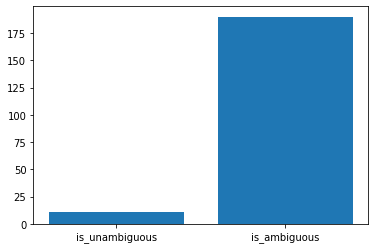

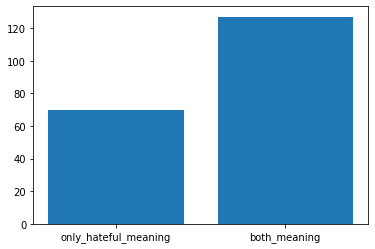

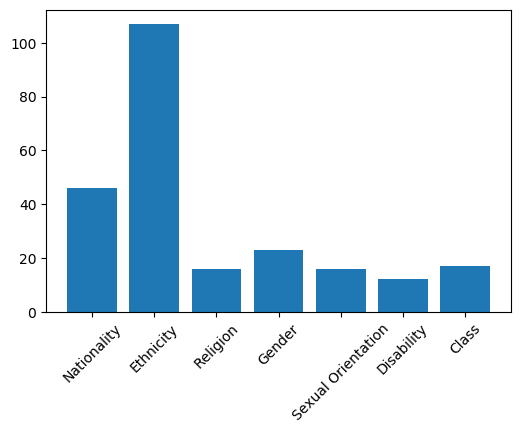

In [10]:

def plot_freq(class_dict, fn):
    num = [len(class_dict[cls]) for cls in class_dict.keys()]
    plt.bar(class_dict.keys(), num)
    plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/{}.png'.format(fn))
    plt.show()
    

plot_freq(ambiguous, "count_ambiguous")
plot_freq(senses, "count_senses")

num = [len(classes[cls]) for cls in classes.keys()]
plt.figure( dpi=100)
plt.bar(classes.keys(), num)

plt.xticks(rotation=45)
plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/count_classes.png')
plt.show()


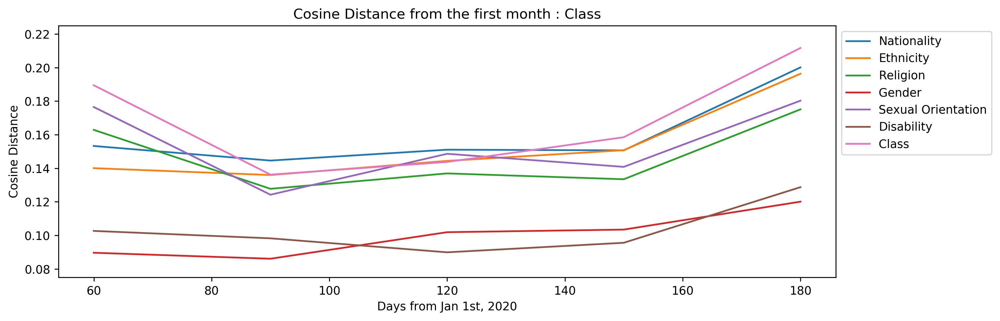

In [24]:
plt.figure(figsize=(12, 4), dpi=250)
for c in classes.keys():
    avg = pd.DataFrame(classes[c]).mean(axis=1)
    plt.plot(avg, label=c)
    plt.xlabel('Days from Jan 1st, 2020')
    plt.ylabel('Cosine Distance')
    plt.title('Cosine Distance from the first month : {}'.format(c))
    plt.ylim([0.075,0.225])
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/{}.png'.format(c), dpi=250)
#     plt.show()

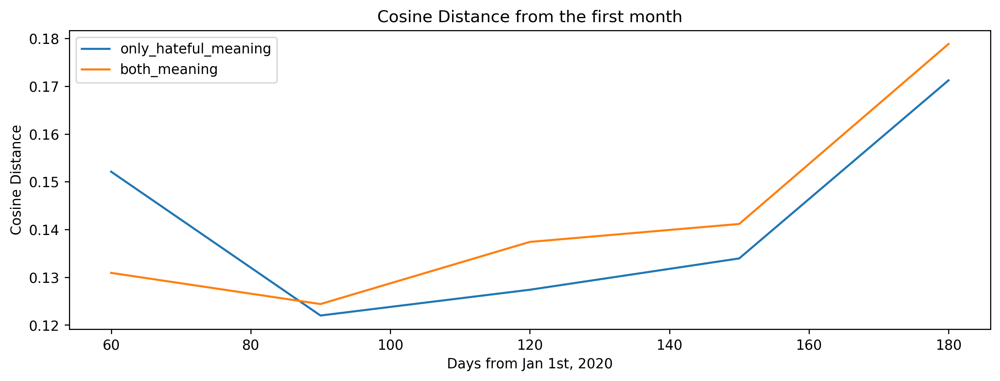

In [25]:
plt.figure(figsize=(12, 4), dpi=250)
for c in senses.keys():
    avg = pd.DataFrame(senses[c]).mean(axis=1)
    plt.plot(avg, label=c)
    plt.xlabel('Days from Jan 1st, 2020')
    plt.ylabel('Cosine Distance')
    plt.title('Cosine Distance from the first month')
#     plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.legend()
    plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/senses.png', dpi=250)
     

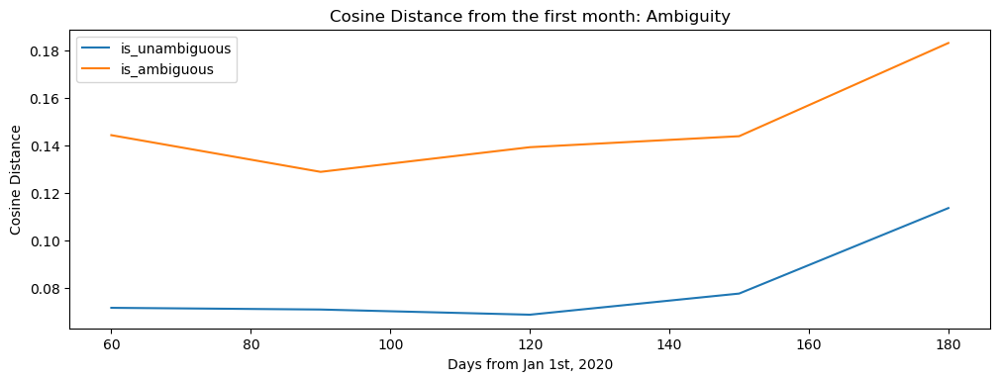

In [20]:
plt.figure(figsize=(12, 4), dpi=100)
for c in ambiguous.keys():
    avg = pd.DataFrame(ambiguous[c]).mean(axis=1)
    plt.plot(avg, label=c)
    plt.xlabel('Days from Jan 1st, 2020')
    plt.ylabel('Cosine Distance')
    
    plt.title('Cosine Distance from the first month: Ambiguity')
    plt.legend()
    plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/ambiguous.png')
     

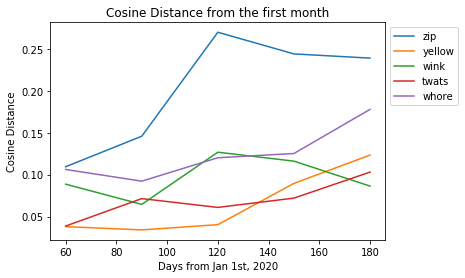

In [26]:
top = ['zip', 'yellow', 'wink', 'twats', 'whore']

for c in top:
    avg = pd.DataFrame(sim_df_notna[c]).mean(axis=1)
    plt.plot(avg, label=c)
    plt.xlabel('Days from Jan 1st, 2020')
    plt.ylabel('Cosine Distance')
    plt.title('Cosine Distance from the first month')
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/senses.png', dpi=300)
     

In [28]:
top = ['zip', 'yellow', 'wink', 'whore', 
       'twat', 'trash', 'tiger', 'tan', 'tinker', 
       'zebra', 'yokels', 'teapot', 'tard', 'whities', 
       'whitey', 'spook', 'spike']

In [29]:
# sim_df_notna[sim_df_notna['term'].isin(top)]
sim_df_notna

,halal,Bengali,Girl,skank,cracker,ABC,cunt,twat,hillbillies,whores,...,ike,nig,fag,rube,yellows,winks,gimps,fuzzies,Yankee,gook
60,0.030741,0.093114,0.056197,0.053925,0.036277,0.059195,0.022424,0.083407,0.099656,0.042417,...,0.411442,0.428526,0.152129,0.104779,0.085215,0.271033,0.104193,0.141914,0.306209,0.277775
90,0.040163,0.109776,0.134132,0.039923,0.039657,0.197959,0.081518,0.163362,0.047596,0.050238,...,0.344988,0.400061,0.087844,0.106844,0.176924,0.343916,0.102931,0.057790,0.236519,0.201187
120,0.046991,0.117423,0.170702,0.086275,0.069720,0.223922,0.083864,0.136544,0.049244,0.078425,...,0.337347,0.450175,0.108613,0.095709,0.160844,0.326421,0.103011,0.051294,0.265142,0.210150
150,0.042387,0.114792,0.154762,0.089343,0.034011,0.240023,0.120181,0.165022,0.052836,0.057961,...,0.387448,0.428699,0.107093,0.102165,0.241126,0.320759,0.103657,0.054072,0.264492,0.174160
180,0.086589,0.112720,0.096012,0.090623,0.071053,0.105801,0.052659,0.151285,0.065358,0.090101,...,0.527429,0.375375,0.129099,0.146067,0.269655,0.551352,0.246629,0.067455,0.262860,0.267104


In [30]:
bottom = ['Bengali', 'Angio', 'greasebali', 'Amos', 'ABC', 'Bihari', 'darkie', 'Amo', 'Bunga', 'Ahab', 'Kushi', 'Annies', 'Armo']

In [ ]:
for c in top:
    avg = pd.DataFrame(sim_df_notna[c]).mean(axis=1)
    plt.plot(avg, label=c)
    plt.xlabel('Days from Jan 1st, 2020')
    plt.ylabel('Cosine Distance')
    plt.title('Cosine Distance from the first month')
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/senses.png', dpi=300)

In [153]:
sim_df_notna

,halal,Bengali,Girl,skank,cracker,ABC,cunt,twat,hillbillies,whores,...,ike,nig,fag,rube,yellows,winks,gimps,fuzzies,Yankee,gook
50,0.030795,0.118069,0.053052,0.046979,0.034854,0.076658,0.021418,0.080365,0.111503,0.044445,...,0.411442,0.498700,0.179063,0.117398,0.106999,0.262441,0.185423,0.162746,0.435687,0.277775
70,0.041998,0.100339,0.093119,0.070175,0.040563,0.075497,0.028146,0.087791,0.051801,0.052968,...,0.623181,0.507851,0.071454,0.117709,0.136376,0.407072,0.126752,0.059850,0.283118,0.261943
90,0.042875,0.135415,0.146148,0.057246,0.047308,0.213647,0.134015,0.210274,0.050837,0.057571,...,0.311648,0.397363,0.110780,0.105325,0.193479,0.344245,0.101491,0.061758,0.233552,0.198772
110,0.043760,0.115859,0.133426,0.092235,0.074777,0.218433,0.101558,0.149755,0.050804,0.073001,...,0.373779,0.445537,0.124241,0.102266,0.158923,0.342160,0.105420,0.054022,0.241738,0.232335
130,0.059821,0.129744,0.235478,0.077552,0.044611,0.241800,0.088863,0.141483,0.051141,0.075288,...,0.399885,0.464792,0.090488,0.101228,0.220624,0.308428,0.089975,0.049164,0.305567,0.161582
150,0.044079,0.123230,0.147990,0.105172,0.040419,0.232951,0.118258,0.184684,0.055558,0.060347,...,0.349185,0.413956,0.122793,0.101400,0.255854,0.348721,0.129595,0.065981,0.265799,0.221194
170,0.086589,0.112720,0.096012,0.090623,0.071053,0.105801,0.052659,0.151285,0.065358,0.090101,...,0.527429,0.375375,0.129099,0.146067,0.269655,0.551352,0.246629,0.067455,0.262860,0.267104


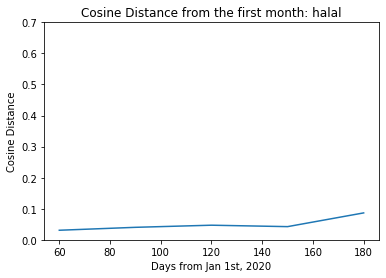

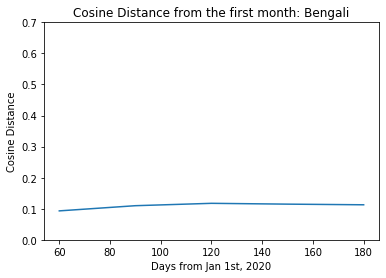

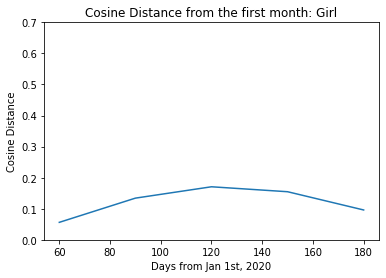

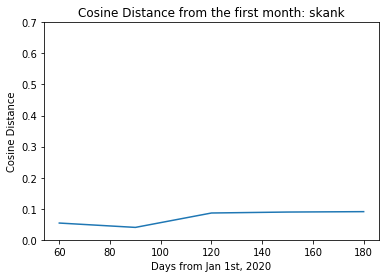

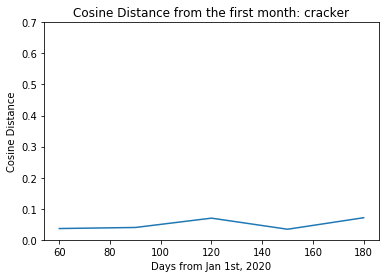

...

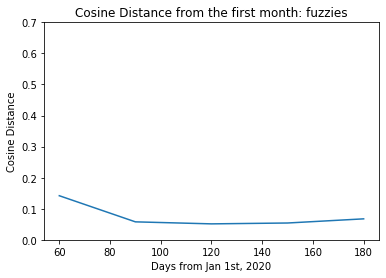

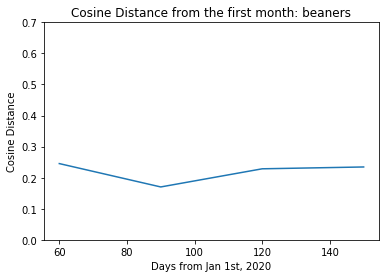

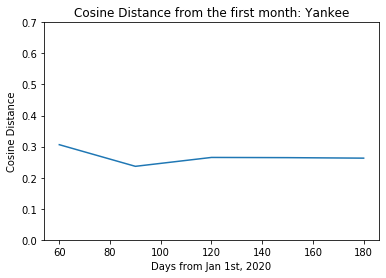

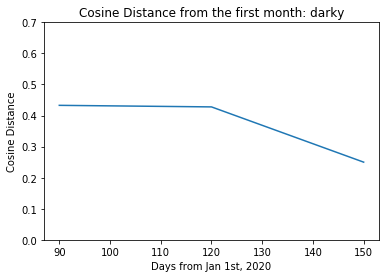

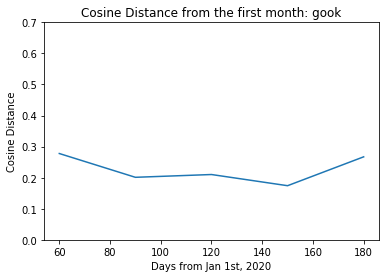

In [31]:
for term in sim_dict_df:
    plt.plot(sim_dict_df[term])
    plt.xlabel('Days from Jan 1st, 2020')
    plt.ylabel('Cosine Distance')
    plt.title('Cosine Distance from the first month: {}'.format(term))
    plt.ylim([0,0.7])
    plt.savefig('/h/ypark/tweet_covid/hatespeech/output/plots/{}.png'.format(term), dpi=300)
    plt.show()
    
     

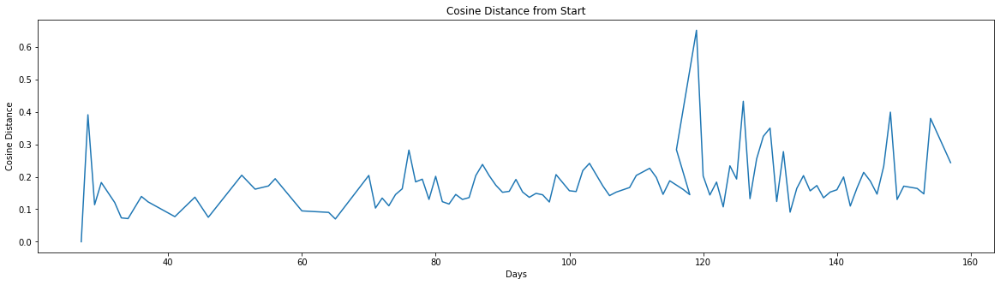

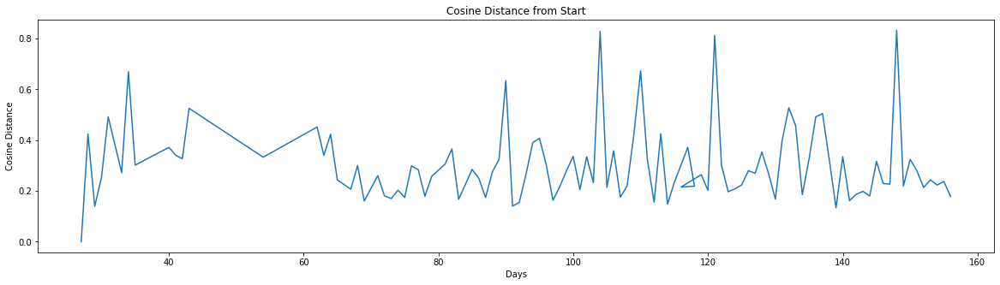

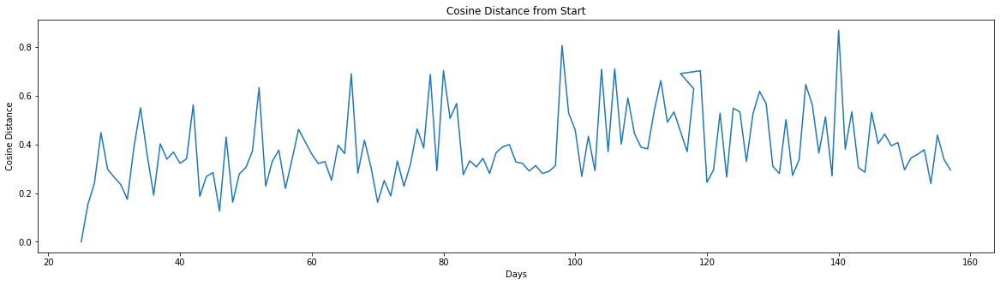

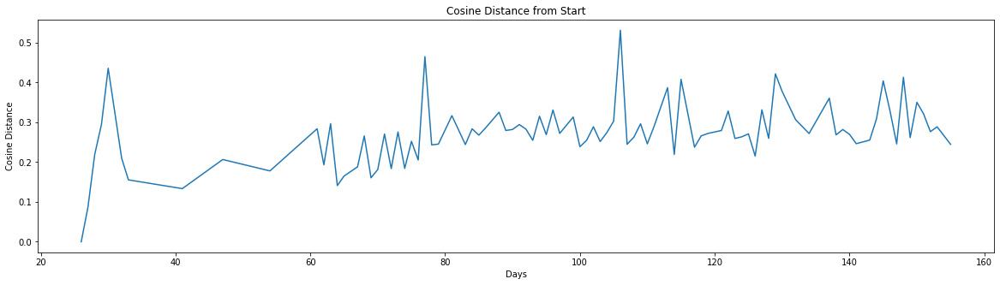

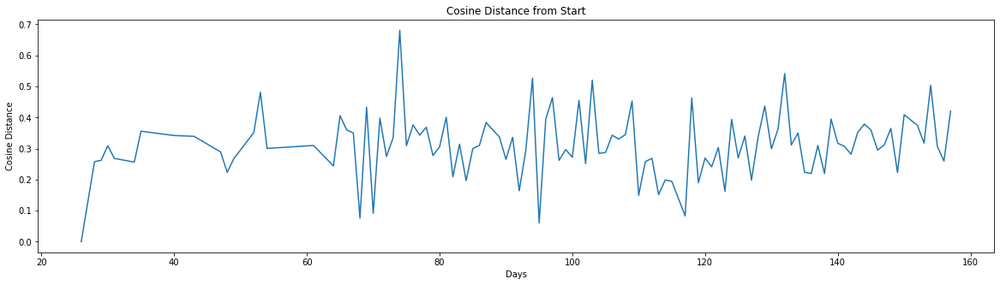

...

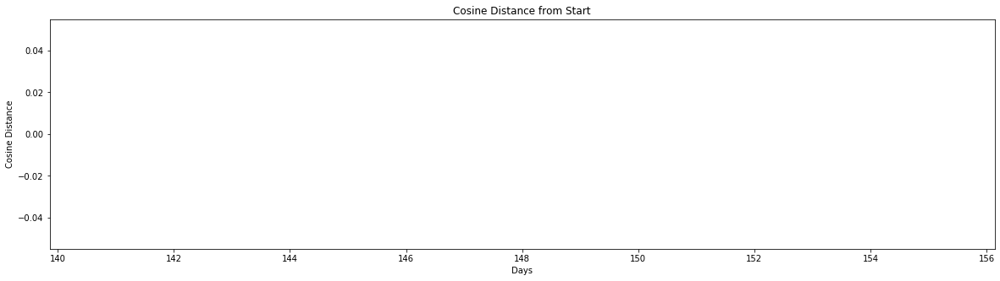

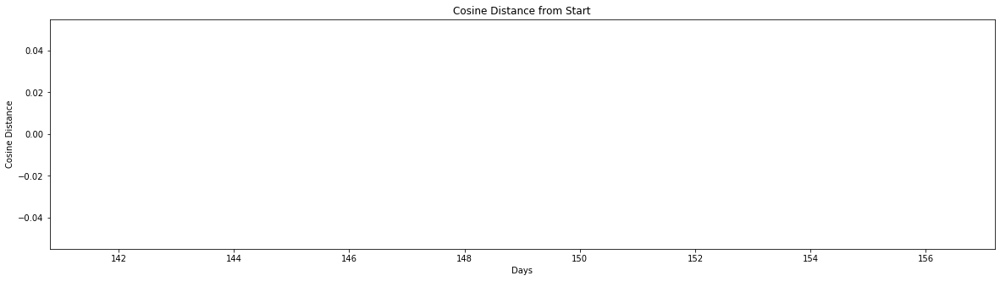

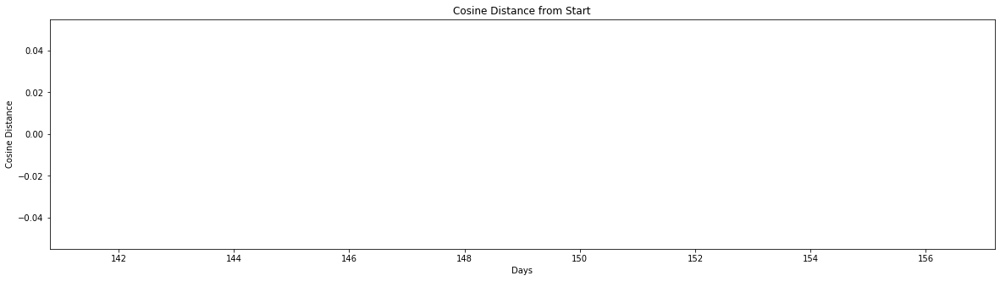

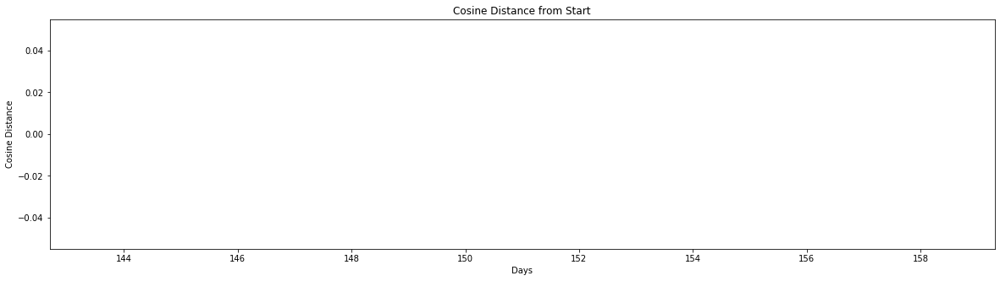

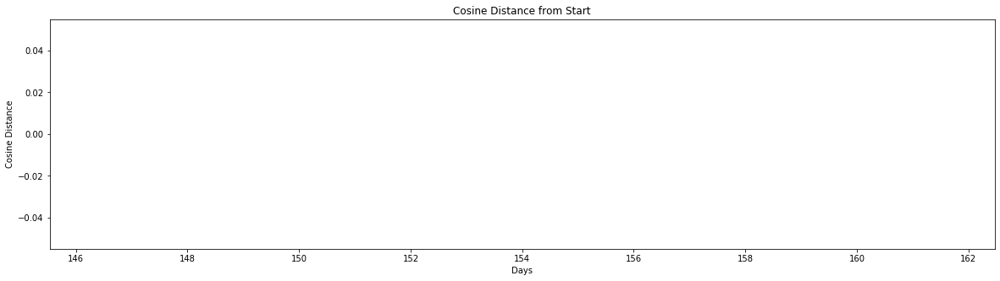

In [27]:
for term in combined.keys(): 
    plt.plot(list(combined[term].keys()), cos_sim_dict[term])
    plt.xlabel('Days')
    plt.ylabel('Cosine Distance')
    plt.title('Cosine Distance from Start')
    plt.rcParams['figure.figsize'] = [20, 5]
    plt.show()
#     plt.savefig('books_read.png')